<a href="https://colab.research.google.com/github/YonDraco/ftech_ai/blob/main/Final_RFM_segmentation_T10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import library

In [1]:
!pip install pyod

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 147 kB 4.9 MB/s 
  Created wheel for pyod: filename=pyod-1.0.7-py3-none-any.whl size=181101 sha256=bb534858c0c8573f00143c4b6e91ecd6287844ff1f008ea3bc65db3b8ee3676b
  Stored in directory: /root/.cache/pip/wheels/f7/e2/c1/1c7fd8b261e72411f6509afb429c84532e40ddcd96074473f4
Successfully built pyod


In [2]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split

import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Set visualization style
sns.set_style("darkgrid")

# EDA

#### Read dataframe

In [3]:
df_all = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T10/RFMD_all_user.csv")
df_paid = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T10/RFMD_paid_user.csv")

In [4]:
df_all.describe()

,duration,monetary,recency,frequency
count,300537.000000,300537.000000,300537.000000,300537.000000
mean,33.898703,12.666327,14.493024,2.736661
std,34.639981,567.478777,9.629085,4.049765
min,0.044717,0.000000,0.000000,1.000000
25%,12.659216,0.000000,6.000000,1.000000
50%,24.412216,0.000000,15.000000,1.000000
75%,42.983616,0.000000,23.000000,3.000000
max,714.778732,181900.000000,30.000000,31.000000


In [12]:
df_all.median()

<ipython-input-12-13294d896614>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_all.median()


duration     24.412216
monetary      0.000000
recency      15.000000
frequency     1.000000
dtype: float64

In [5]:
df_all

,duration,monetary,recency,frequency,account_id
0,714.778732,0,0,3,635c8cf81505f828cf79d3d6
1,700.352309,0,16,1,6349a08e1505f828cf787f36
2,679.467301,300,0,7,635724051505f828cf798504
3,665.620019,0,0,31,631dcac71505f8fb5aab0c72
4,632.563903,0,13,1,634dfd161505f828cf78de64
...,...,...,...,...,...
300532,0.054667,0,9,1,62e9dfed1505f8c1cf2b5b1e
300533,0.054133,0,9,1,635306871505f828cf793092
300534,0.053283,0,20,1,63452f141505f828cf78334a
300535,0.048617,0,8,1,63543f9b1505f828cf794e40


In [6]:
df_paid.describe()

,duration,monetary,recency,frequency
count,2259.000000,2259.000000,2259.000000,2259.000000
mean,110.100662,1685.126162,4.835325,18.561753
std,66.964921,6327.905258,7.769679,10.934383
min,0.514050,100.000000,0.000000,1.000000
25%,61.948779,100.000000,0.000000,8.000000
50%,97.086688,500.000000,0.000000,20.000000
75%,141.585644,1250.000000,7.000000,30.000000
max,679.467301,181900.000000,30.000000,31.000000


In [7]:
df_paid

,duration,monetary,recency,frequency,account_id
0,117.249550,200,2,19,62d80ea81505f84bf054dc59
1,218.915418,100,0,8,62d80efb1505f84bf054dc77
2,79.135264,200,4,15,62d80f321505f84bf054dc87
3,256.817099,51900,0,31,62d80fe61505f84bf054dcc6
4,130.634784,450,0,31,62d8103b1505f84bf054dcec
...,...,...,...,...,...
2254,148.804401,100,0,1,635ebeed1505f828cf7a09e1
2255,162.692703,100,0,1,635f26031505f828cf7a0b45
2256,209.141602,100,0,1,635f5a021505f828cf7a0e01
2257,34.561550,2500,0,1,635f8c911505f828cf7a1085


In [8]:
dfa_dropid = df_all.drop(columns = 'account_id')
dfp_dropid = df_paid.drop(columns = 'account_id')

#### Draw

##### Heatmap

Text(0.5, 1.0, 'Heatmap')

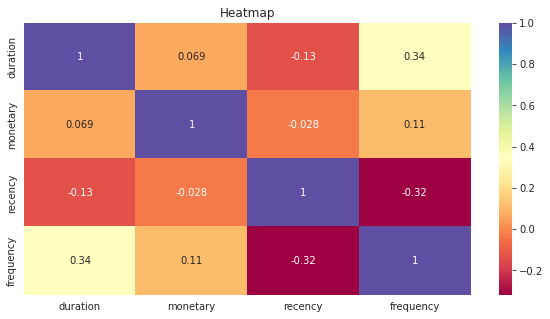

In [ ]:
plt.figure(figsize=(10,5))
sns.heatmap(dfa_dropid.corr(), annot=True, cmap='Spectral')
plt.title("Heatmap")

Text(0.5, 1.0, 'Heatmap')

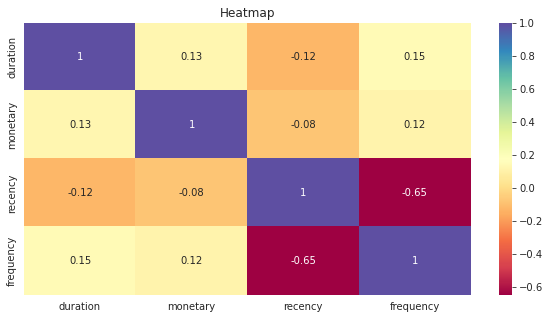

In [ ]:
plt.figure(figsize=(10,5))
sns.heatmap(dfp_dropid.corr(), annot=True, cmap='Spectral')
plt.title("Heatmap")

##### Pairplot

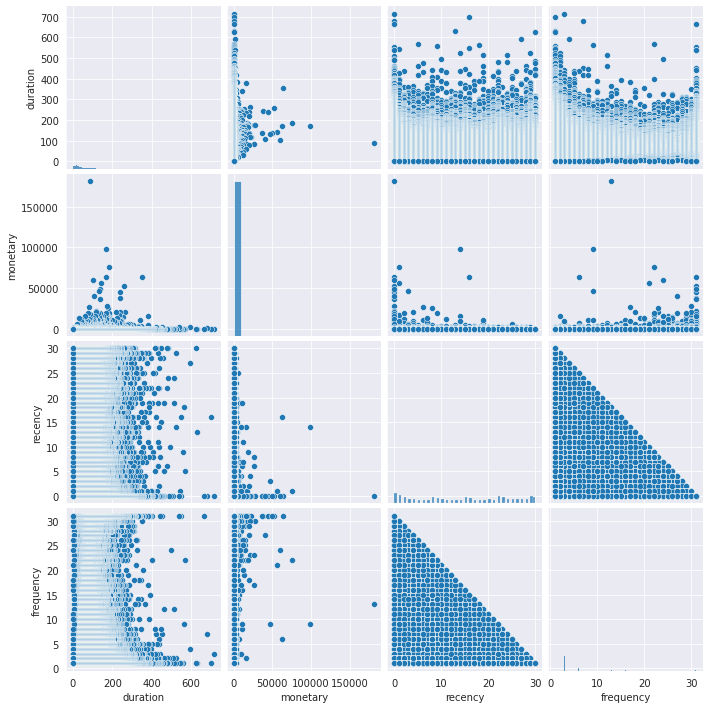

In [ ]:
sns.pairplot(dfa_dropid, kind="scatter")
plt.show()

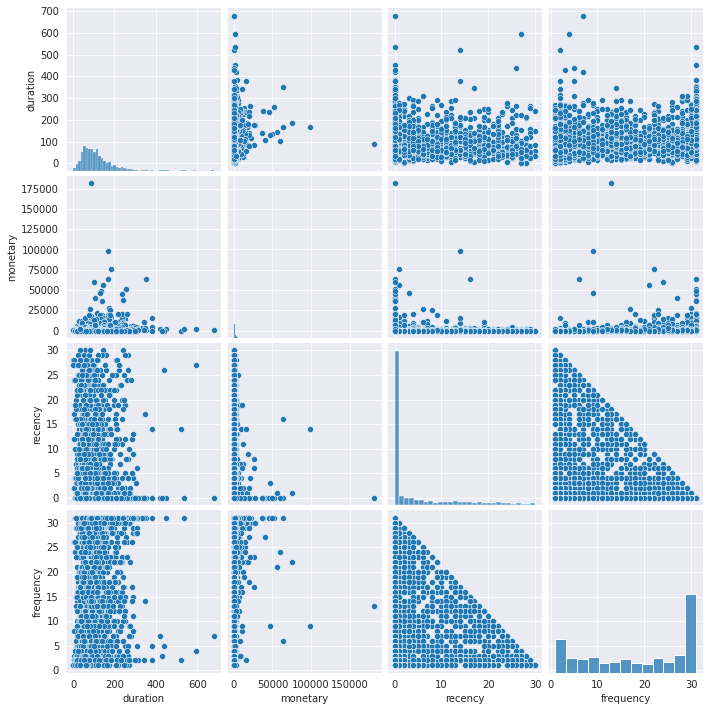

In [ ]:
sns.pairplot(dfp_dropid, kind="scatter")
plt.show()

##### Distribution visualization

###### df_all

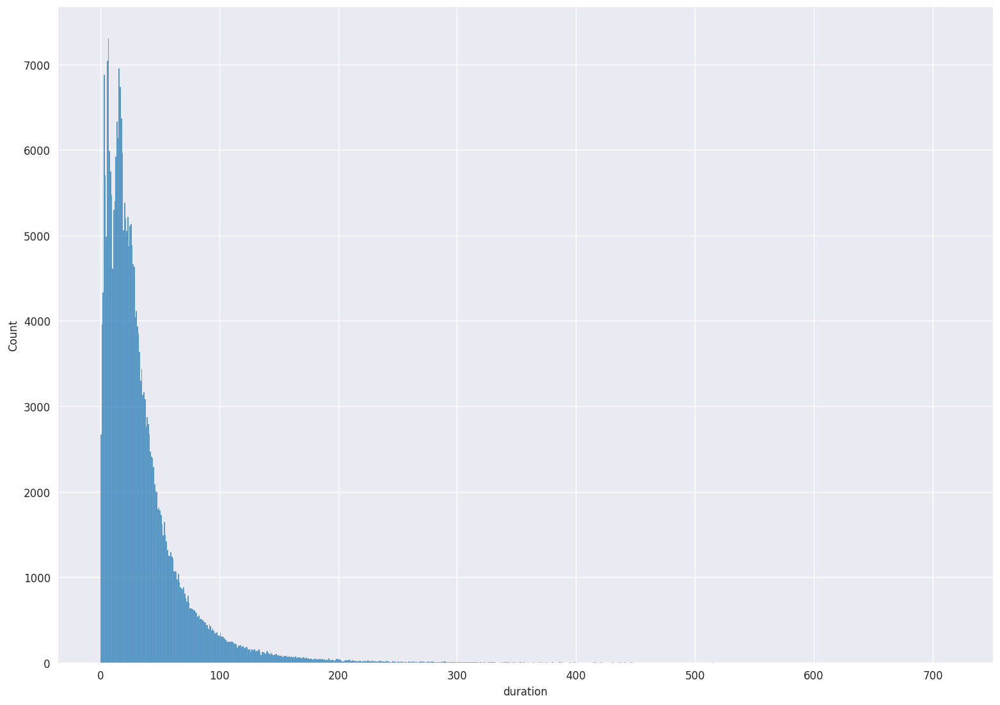

In [ ]:
p = sns.displot(dfa_dropid['duration'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

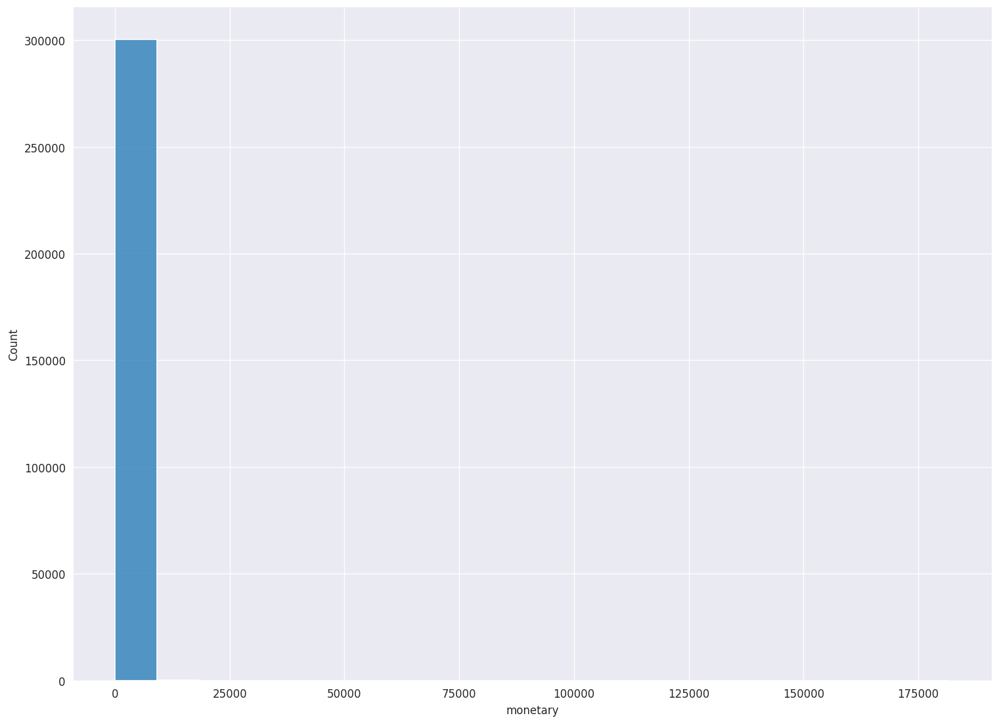

In [ ]:
p = sns.displot(dfa_dropid['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

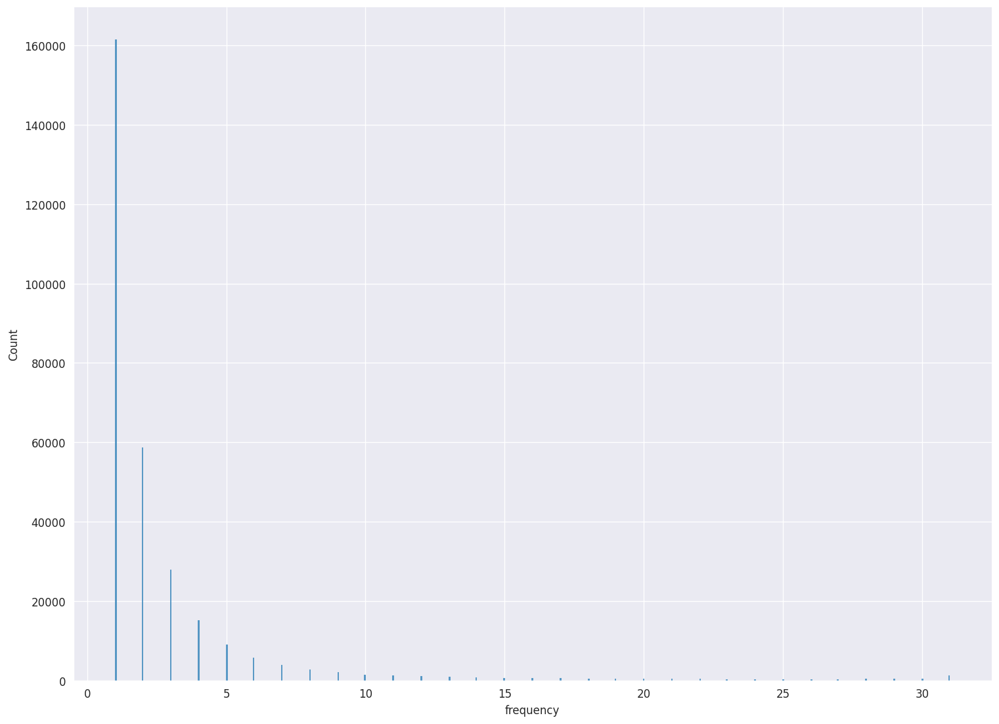

In [ ]:
p = sns.displot(dfa_dropid['frequency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

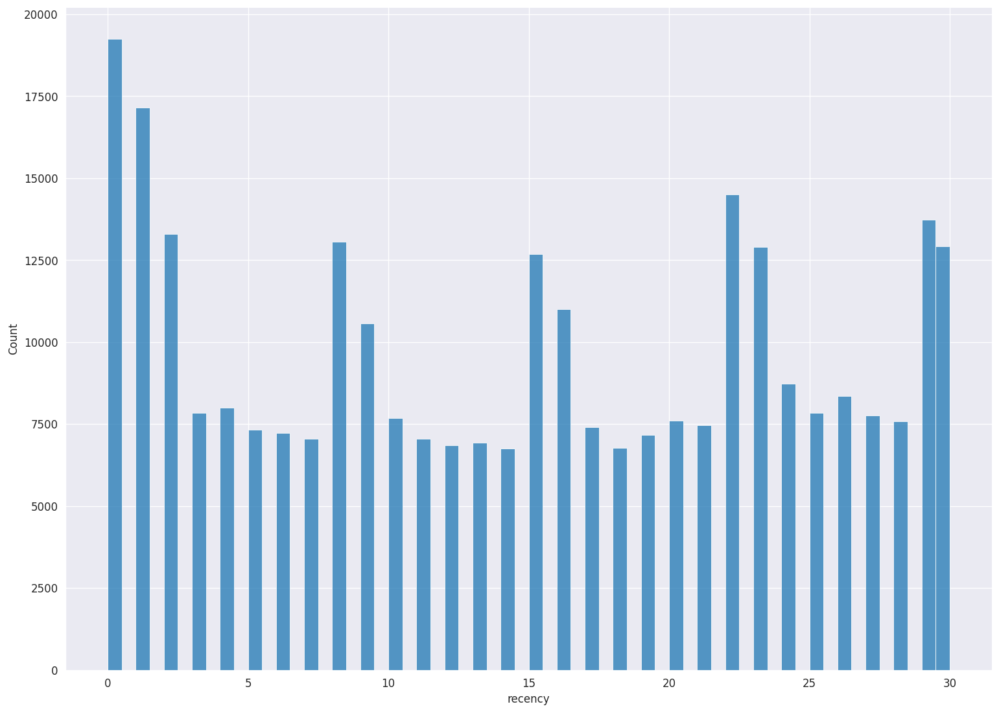

In [ ]:
p = sns.displot(dfa_dropid['recency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

###### df_paid

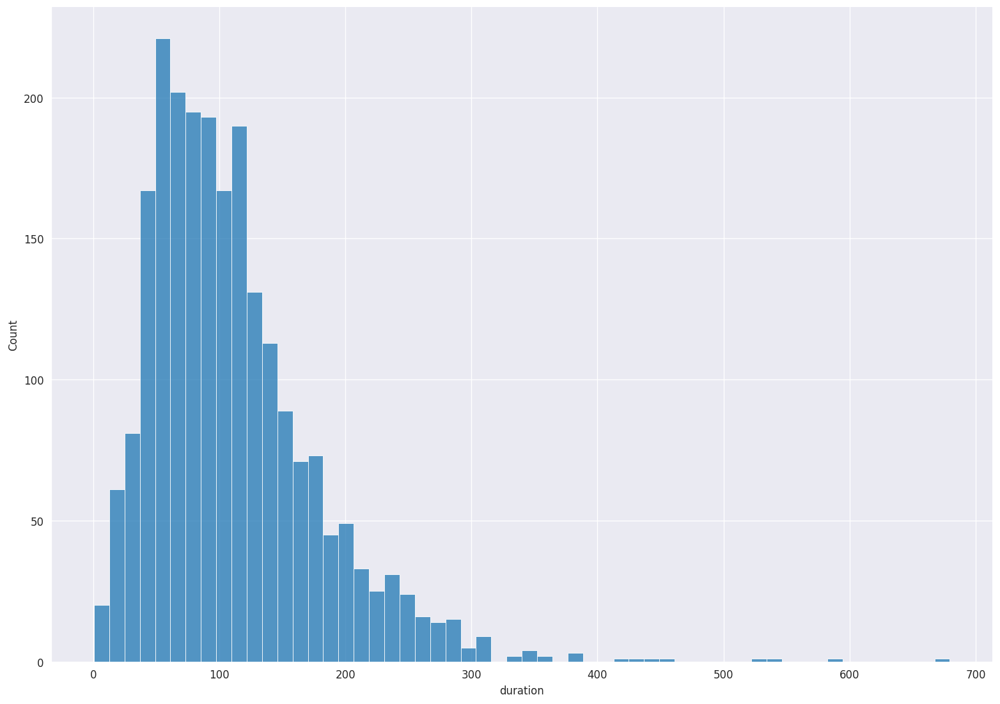

In [ ]:
p = sns.displot(dfp_dropid['duration'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

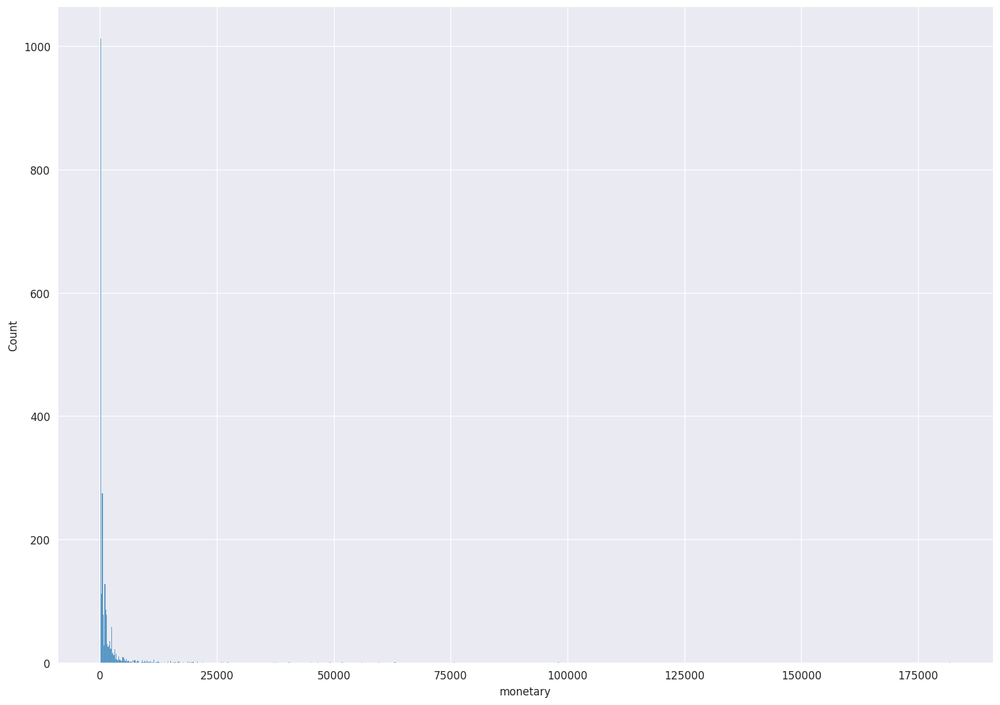

In [ ]:
p = sns.displot(dfp_dropid['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

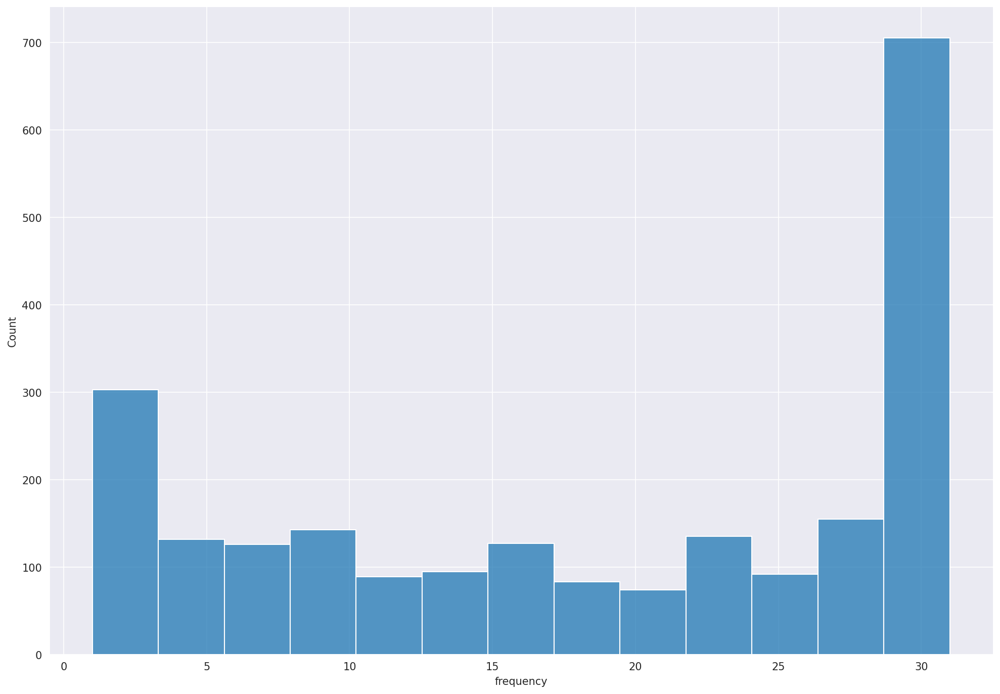

In [ ]:
p = sns.displot(dfp_dropid['frequency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(150)

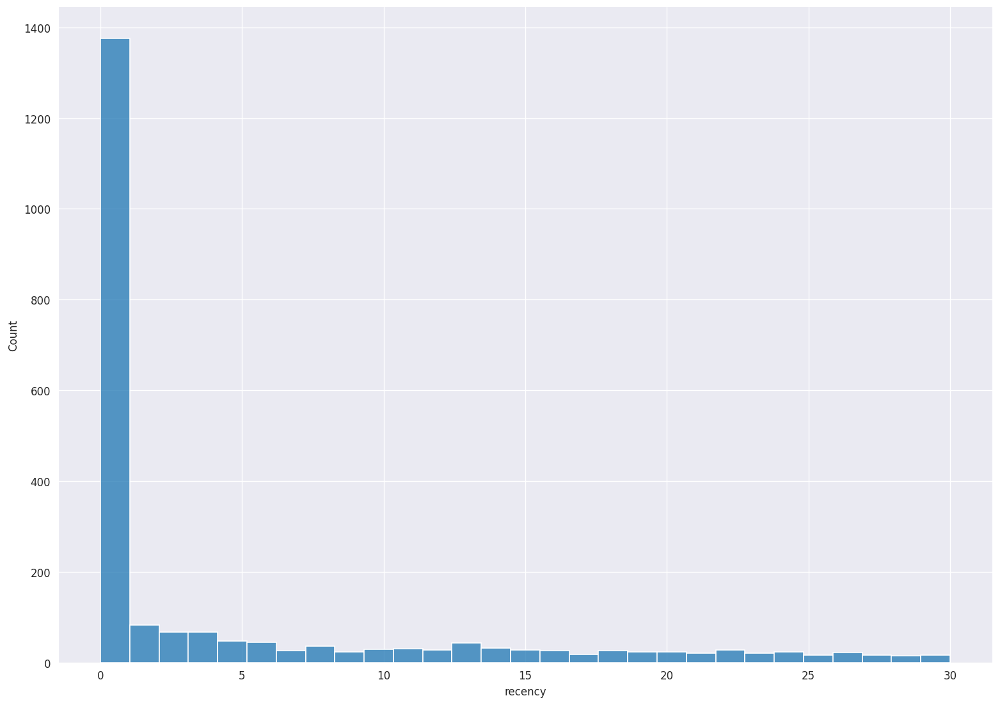

In [ ]:
p = sns.displot(dfp_dropid['recency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

# Process noise

### Duration
Một session có thời gian chơi khoảng 2p nên các value duration <2 sẽ được coi là noise và tiến hành loại bỏ

In [10]:
# Get value with condition
dfa_dropid_rn = dfa_dropid[dfa_dropid.duration >2]
# dfp_dropid_rn = dfp_dropid[dfp_dropid.duration >2]

In [11]:
dfa_dropid_rn.describe()

,duration,monetary,recency,frequency
count,293305.000000,293305.000000,293305.000000,293305.000000
mean,34.705944,12.970969,14.438404,2.777409
std,34.676062,574.422864,9.632920,4.089070
min,2.000033,0.000000,0.000000,1.000000
25%,13.490434,0.000000,6.000000,1.000000
50%,25.001544,0.000000,15.000000,1.000000
75%,43.642362,0.000000,23.000000,3.000000
max,714.778732,181900.000000,30.000000,31.000000


# Process outliers

## Method quan sát

### Duration

In [146]:
df_boxplot = pd.DataFrame(dfa_dropid_rn['duration'])
fig = px.box(df_boxplot)
fig.show()

### Monetary

In [147]:
df_boxplot = pd.DataFrame(df_paid['monetary'])
fig = px.box(df_boxplot)
fig.show()

## Method IQR

### Duration

In [148]:
Q1 = dfa_dropid_rn['duration'].quantile(0.25)
Q3 = dfa_dropid_rn['duration'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5*IQR
upper = Q3 + 1.5*IQR

In [149]:
outlier= dfa_dropid_rn[(dfa_dropid_rn['duration'] < lower) | (dfa_dropid_rn['duration'] > upper)]

In [150]:
outlier['duration'].describe()

count    18946.000000
mean       133.300124
std         50.953716
min         88.873276
25%         99.964831
50%        116.957785
75%        147.768516
max        714.778732
Name: duration, dtype: float64

In [151]:
outlier['duration'].to_csv("T11_iqr_od.csv")

### Monetary

In [152]:
Q1 = df_paid['monetary'].quantile(0.25)
Q3 = df_paid['monetary'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5*IQR
upper = Q3 + 1.5*IQR

In [153]:
outlier= df_paid[(df_paid['monetary'] < lower) | (df_paid['monetary'] > upper)]

In [154]:
outlier['monetary'].describe()

count       231.000000
mean      11052.813853
std       17050.591686
min        3000.000000
25%        3825.000000
50%        5600.000000
75%       11000.000000
max      181900.000000
Name: monetary, dtype: float64

In [155]:
outlier['monetary'].to_csv("T11_iqr_om.csv")

## Method standard deviation, z-score

In [156]:
from scipy.stats import zscore

### Duration

In [157]:
scores = zscore(dfa_dropid_rn)
is_over_3 = np.abs(scores) > 3
outliers_d = dfa_dropid_rn[is_over_3]

In [158]:
outliers_d = pd.DataFrame(outliers_d)
outliers_d["duration"].describe()

count    5795.000000
mean      190.380102
std        57.951785
min       138.735818
25%       151.832536
50%       171.618809
75%       207.783142
max       714.778732
Name: duration, dtype: float64

In [159]:
outliers_d['duration'].to_csv("T11_z_od.csv")

### Monetary

In [160]:
scores = zscore(dfp_dropid)
is_over_3 = np.abs(scores) > 3
outliers_m = df_paid[is_over_3]

In [161]:
outliers_m = pd.DataFrame(outliers_m)
outliers_m["monetary"].describe()

count        20.000000
mean      52462.500000
std       36512.228936
min       20800.000000
25%       27100.000000
50%       45775.000000
75%       60625.000000
max      181900.000000
Name: monetary, dtype: float64

In [162]:
outliers_m['monetary'].to_csv("T11_z_om.csv")

## Method: MAD
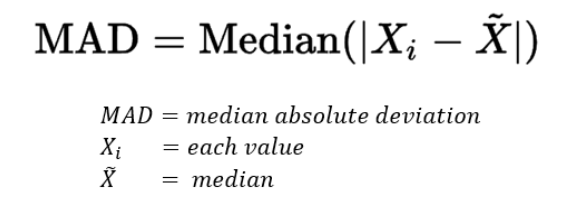

In [163]:
from scipy.stats import median_abs_deviation
from pyod.models.mad import MAD

In [164]:
df_mad_d = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T9/duration_mad.csv")
df_mad_m = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T9/monetary_mad.csv")

### Duration

In [165]:
df_mad_d = df_mad_d[df_mad_d.duration >2]

In [166]:
df_mad_d.describe()

,duration
count,395571.000000
mean,38.210368
std,47.058588
min,2.000017
25%,15.034725
50%,24.590700
75%,45.212269
max,3756.223764


In [167]:
mad_score = median_abs_deviation(df_mad_d['duration'])
mad_score
# có thể thay thế giá trị này thay cho std trong công thức z-score

13.10220051

In [168]:
mad = MAD(threshold=19.5)

df_mad_d_reshaped = df_mad_d.values.reshape(-1, 1)
labels = mad.fit_predict(df_mad_d_reshaped)

# Filter outliers
outliers = df_mad_d[labels == 1]

print(len(outliers))

564


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function fit_predict is deprecated



In [169]:
outliers = pd.DataFrame(outliers)
outliers.describe()

,duration
count,564.000000
mean,596.845893
std,316.016769
min,403.448229
25%,441.079416
50%,491.943160
75%,607.416022
max,3756.223764


### Monetary

In [170]:
mad_score = median_abs_deviation(df_mad_m['monetary'])
mad_score

200.0

In [171]:
mad = MAD(threshold=50)

df_mad_d_reshaped = df_mad_d.values.reshape(-1, 1)
labels = mad.fit_predict(df_mad_d_reshaped)

# Filter outliers
outliers = df_mad_d[labels == 1]

print(len(outliers))

37


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function fit_predict is deprecated



In [172]:
outliers = pd.DataFrame(outliers)
outliers.describe()

,duration
count,37.000000
mean,1518.332821
std,603.628295
min,1063.542114
25%,1164.858276
50%,1184.009399
75%,1865.953616
max,3756.223764


# Method Robust covariance
from sklearn.covariance import EllipticEnvelope

## Method IsolationForest

In [27]:
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split

In [28]:
from sklearn.metrics \
import (confusion_matrix, precision_score,recall_score)

In [29]:
from sklearn.metrics import classification_report,accuracy_score

### Duration

In [30]:
dfa_dropid_rn.head()

,duration,monetary,recency,frequency
0,714.778732,0,0,3
1,700.352309,0,16,1
2,679.467301,300,0,7
3,665.620019,0,0,31
4,632.563903,0,13,1


In [31]:
df = dfa_dropid_rn

In [32]:
CONTAMINATION=.03
#.1   
BOOTSTRAP = False   

data = df.values

# X, y = data[:, :-1], data[:, -1]
X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

i_forest = IsolationForest(contamination=CONTAMINATION, bootstrap=BOOTSTRAP)
is_inlier = i_forest.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [33]:
print(accuracy_score(mask,is_inlier))

0.9699971019928061


In [35]:
print(classification_report(is_inlier,mask))

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00      7040
           0       0.00      0.00      0.00         0
           1       1.00      1.00      1.00    227604

    accuracy                           0.97    234644
   macro avg       0.33      0.33      0.33    234644
weighted avg       0.97      0.97      0.97    234644



/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1

In [36]:
df_wo_outliers = pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['duration'], 'Without outliers':df_wo_outliers['duration']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



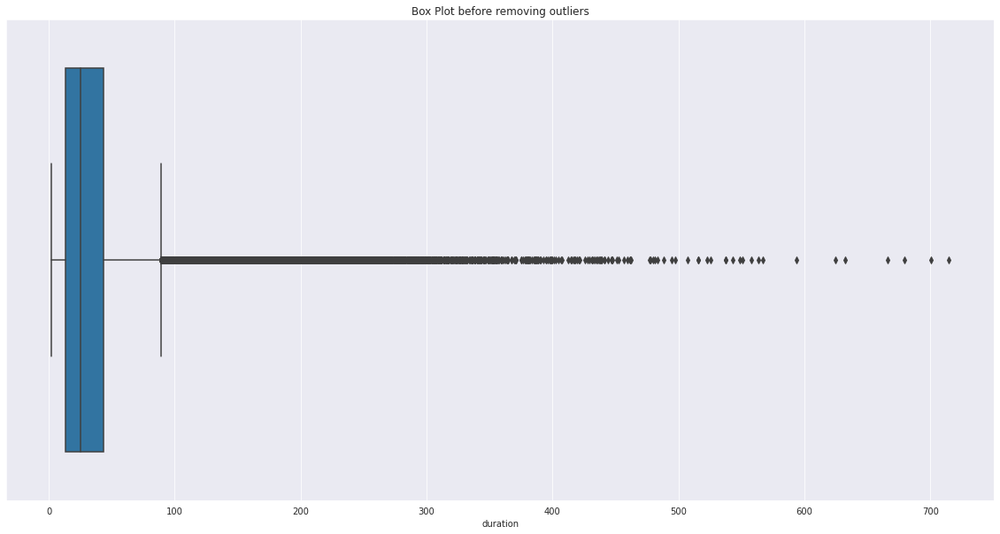

In [37]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['duration']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



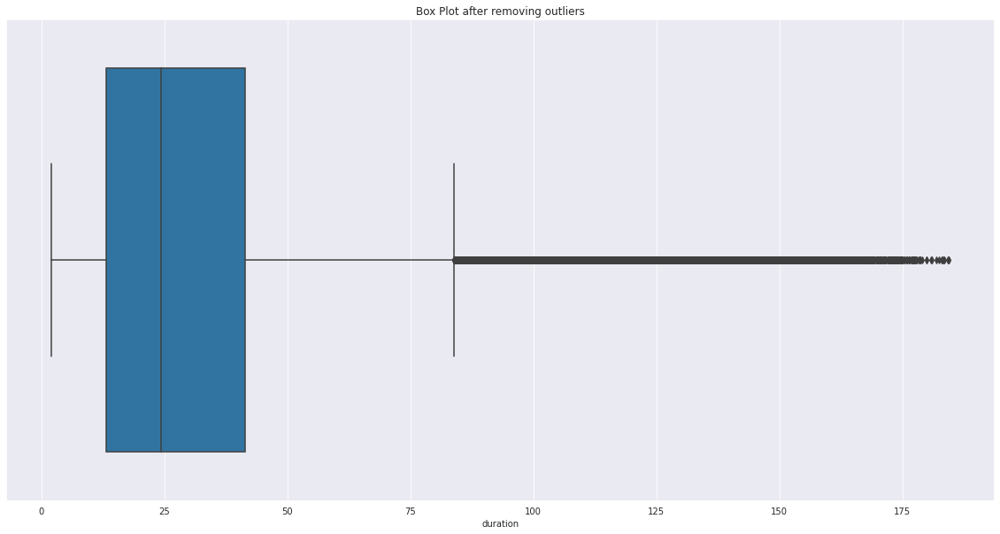

In [38]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['duration']).set(title="Box Plot after removing outliers")
plt.show()

In [39]:
df_wo_outliers['duration'].describe()

count    227604.000000
mean         31.506906
std          26.614020
min           2.000033
25%          13.159374
50%          24.262558
75%          41.469538
max         184.525612
Name: duration, dtype: float64

In [40]:
max = df_wo_outliers['duration'].max()

In [41]:
# Get value with condition
df_all_od = df[df['duration'] > max]  
df_all_od['duration'].describe()

count    2269.000000
mean      241.616856
std        63.272525
min       184.556127
25%       199.303663
50%       221.767155
75%       262.341831
max       714.778732
Name: duration, dtype: float64

In [42]:
df_all_od['duration'].to_csv("T10_iso_od_0.03.csv")

### Monetary

In [43]:
df  = dfp_dropid

In [44]:
CONTAMINATION=.03  
BOOTSTRAP = False   

data = df.values

# X, y = data[:, :-1], data[:, -1]
X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

i_forest = IsolationForest(contamination=CONTAMINATION, bootstrap=BOOTSTRAP)
is_inlier = i_forest.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [45]:
print(accuracy_score(mask,is_inlier))

0.96956281128943


In [46]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['monetary'], 'Without outliers':df_wo_outliers['monetary']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



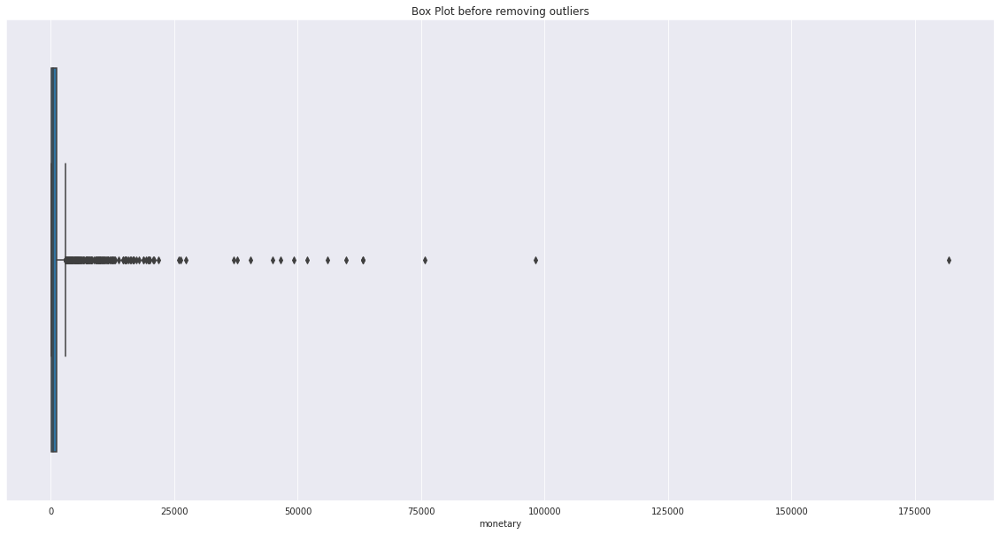

In [47]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['monetary']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



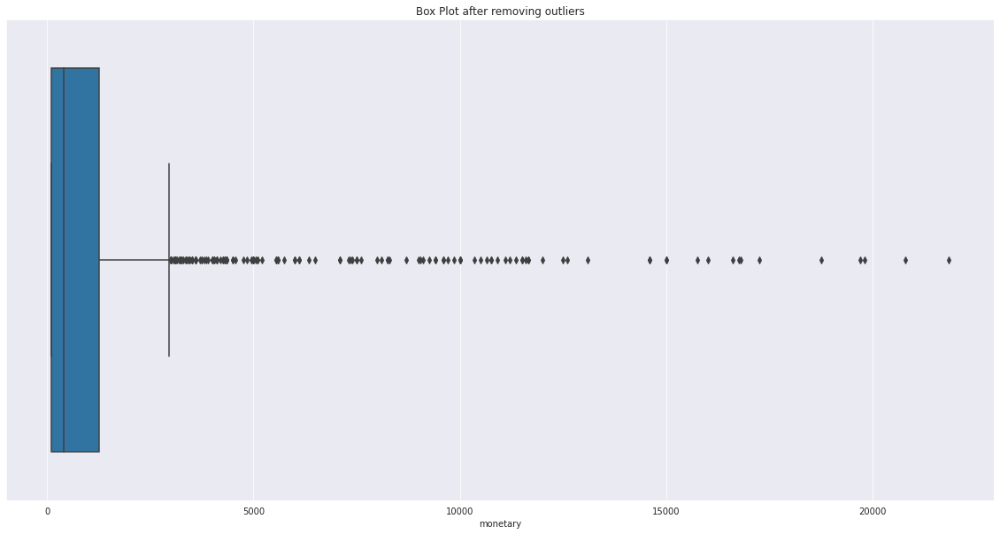

In [48]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['monetary']).set(title="Box Plot after removing outliers")
plt.show()

In [49]:
df_wo_outliers['monetary'].describe()

count     1752.000000
mean      1175.313927
std       2330.398993
min        100.000000
25%        100.000000
50%        400.000000
75%       1250.000000
max      21850.000000
Name: monetary, dtype: float64

In [50]:
max = df_wo_outliers['monetary'].max()

In [51]:
# Get value with condition
df_paid_om = df[df['monetary'] > max]  
df_paid_om['monetary'].describe()

count        17.000000
mean      57982.352941
std       36976.271704
min       26000.000000
25%       37750.000000
50%       49300.000000
75%       63100.000000
max      181900.000000
Name: monetary, dtype: float64

In [52]:
df_paid_om['monetary'].to_csv("T10_iso_om_0.03.csv")

## Method One class SVM

In [53]:
from sklearn.svm import OneClassSVM
import pandas as pd
from pandas import DataFrame
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.pyplot import figure

In [54]:
from numpy import quantile, random, where

In [55]:
from sklearn.metrics import classification_report,accuracy_score

In [56]:
from sklearn.metrics \
import (confusion_matrix, precision_score,recall_score)

### Duration

In [57]:
df = dfa_dropid_rn

In [58]:
data = df.values

X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
model_ocs = OneClassSVM(nu=0.03, kernel="rbf", gamma='scale')
is_inlier = model_ocs.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [59]:
print(accuracy_score(mask,is_inlier))

0.9700013637680912


In [60]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['duration'], 'Without outliers':df_wo_outliers['duration']})
fig = px.box(df_boxplot)
fig.show()

In [61]:
import matplotlib.pyplot as plt

In [62]:
# plt.scatter(df["duration"], , c='#9467bd')

In [63]:
# threedee = plt.figure(figsize=(15,15)).gca(projection='3d')
# threedee.scatter(df.index, df['duration'], df['monetary'])
# threedee.scatter(df_od.index, df_od["duration"], df_od["monetary"], c = "r")
# threedee.set_xlabel('monetary')
# threedee.set_ylabel('index')
# threedee.set_zlabel('duration')
# plt.show()

In [64]:
# plt.scatter(df_wo_outliers["duration"], df_wo_outliers["moneytary"])
# plt.scatter(df_od["duration"], df_od["moneytary"], c = "r")

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



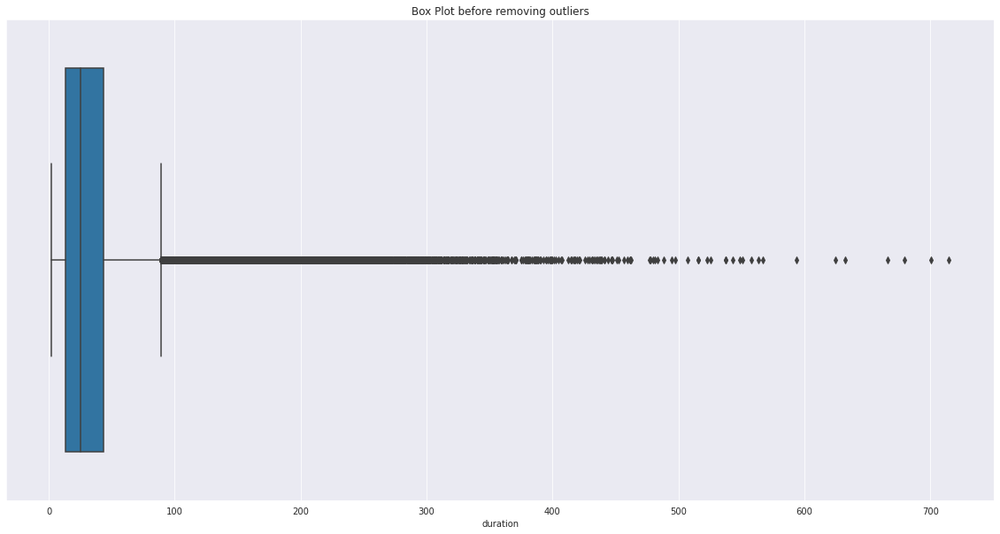

In [65]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['duration']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



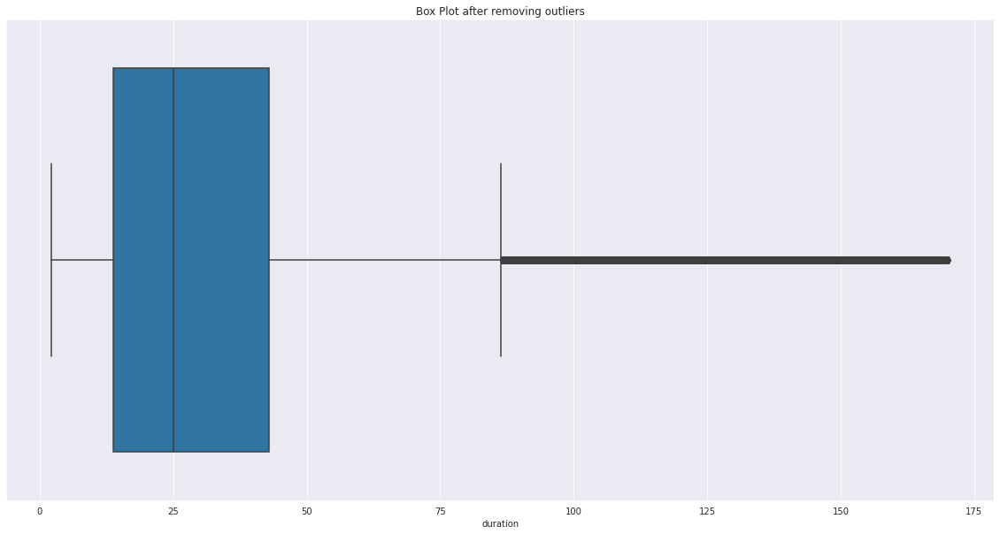

In [66]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['duration']).set(title="Box Plot after removing outliers")
plt.show()

In [67]:
confusion_matrix(is_inlier, mask)

array([[     0,   7039,      0],
       [     0,      0,      0],
       [     0,      0, 227605]])

In [68]:
df_wo_outliers['duration'].describe()

count    227605.000000
mean         32.847047
std          27.711774
min           2.152550
25%          13.805583
50%          24.989866
75%          42.860035
max         170.301013
Name: duration, dtype: float64

In [69]:
max = df_wo_outliers['duration'].max()
min = df_wo_outliers['duration'].min()

In [70]:
df_od = df[(df['duration'] > max) | (df['duration'] < min)]

In [71]:
df_od['duration'].describe()

count    3617.000000
mean      187.104564
std       101.759507
min         2.000033
25%       175.001101
50%       196.175063
75%       234.331154
max       714.778732
Name: duration, dtype: float64

In [72]:
df_od['duration'].to_csv("T10_ocs_od.csv")

### Monetary

In [73]:
df = dfp_dropid

In [74]:
data = df.values

X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
model_ocs = OneClassSVM(nu=0.03, kernel="rbf", gamma='scale')
is_inlier = model_ocs.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [82]:
print(accuracy_score(mask,is_inlier))

0.9712230215827338


In [75]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['monetary'], 'Without outliers':df_wo_outliers['monetary']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



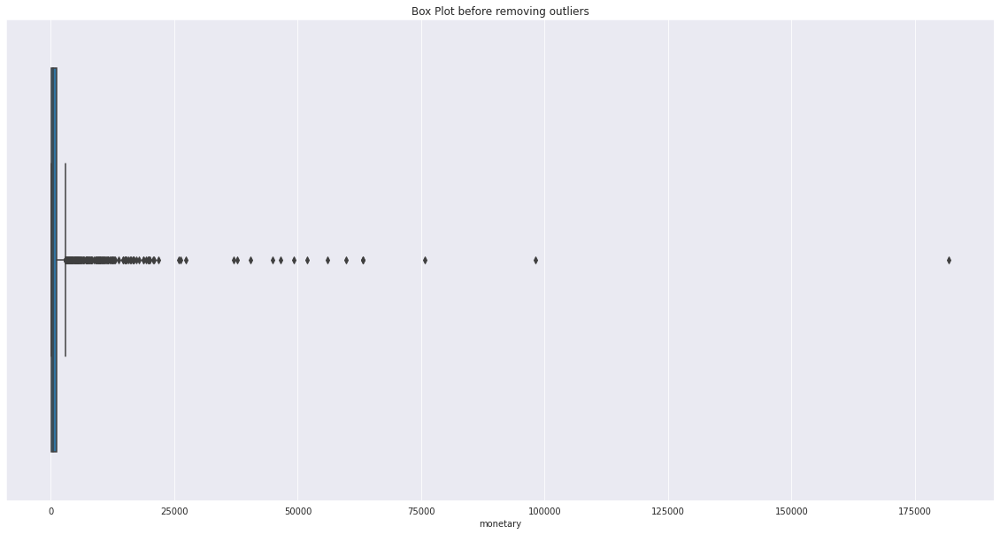

In [76]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['monetary']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



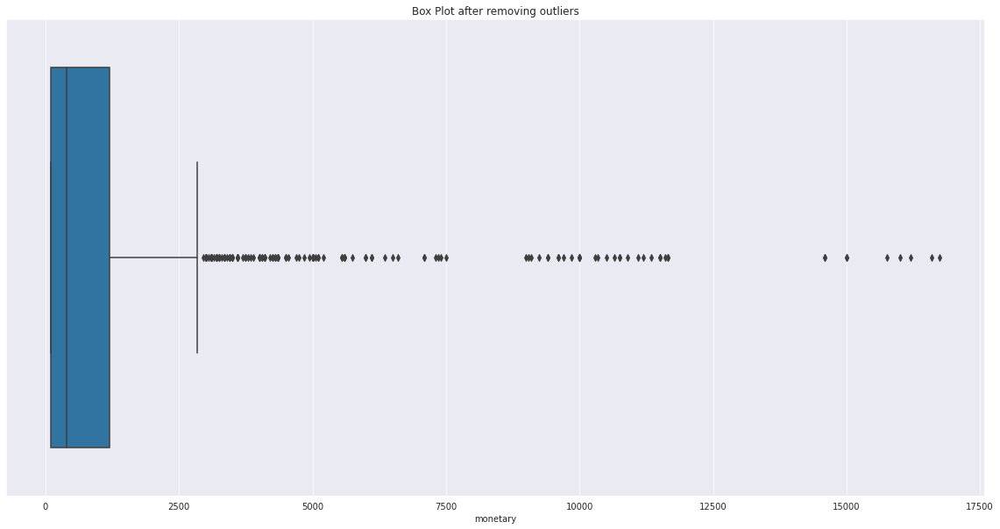

In [77]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['monetary']).set(title="Box Plot after removing outliers")
plt.show()

In [78]:
df_wo_outliers['monetary'].describe()

count     1755.000000
mean      1071.823362
std       1957.479030
min        100.000000
25%        100.000000
50%        400.000000
75%       1200.000000
max      16750.000000
Name: monetary, dtype: float64

In [79]:
max = df_wo_outliers['monetary'].max()

In [80]:
# Get value with condition
df_paid_om = df[df['monetary'] > max]  
df_paid_om['monetary'].describe()

count        30.000000
mean      41248.333333
std       33675.654983
min       16800.000000
25%       19837.500000
50%       26800.000000
75%       51250.000000
max      181900.000000
Name: monetary, dtype: float64

In [81]:
df_paid_om['monetary'].to_csv("T10_ocs_om.csv")

## Method KNN

In [174]:
from pyod.models.knn import KNN
from sklearn.linear_model import LinearRegression

### Duration

In [175]:
df_paid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2259 entries, 0 to 2258
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   duration    2259 non-null   float64
 1   monetary    2259 non-null   int64  
 2   recency     2259 non-null   int64  
 3   frequency   2259 non-null   int64  
 4   account_id  2259 non-null   object 
dtypes: float64(1), int64(3), object(1)
memory usage: 88.4+ KB


In [176]:
df = df_paid.drop(columns=['account_id'])

In [177]:
df

,duration,monetary,recency,frequency
0,117.249550,200,2,19
1,218.915418,100,0,8
2,79.135264,200,4,15
3,256.817099,51900,0,31
4,130.634784,450,0,31
...,...,...,...,...
2254,148.804401,100,0,1
2255,162.692703,100,0,1
2256,209.141602,100,0,1
2257,34.561550,2500,0,1


In [178]:
knn = KNN(contamination=0.01, n_neighbors=20, n_jobs=-1)
knn.fit(df)

is_outlier = knn.labels_ == 1

outliers = df[is_outlier]

print(len(outliers))

23


In [179]:
outliers.describe()

,duration,monetary,recency,frequency
count,23.000000,23.000000,23.000000,23.000000
mean,173.058747,48217.391304,2.304348,23.782609
std,67.313605,35734.467728,4.557060,8.190663
min,82.621965,19800.000000,0.000000,6.000000
25%,124.785715,23925.000000,0.000000,19.500000
50%,168.864462,40500.000000,0.000000,27.000000
75%,226.740538,57950.000000,2.000000,31.000000
max,352.698276,181900.000000,16.000000,31.000000


In [180]:
outliers.to_csv("knn_om.csv")

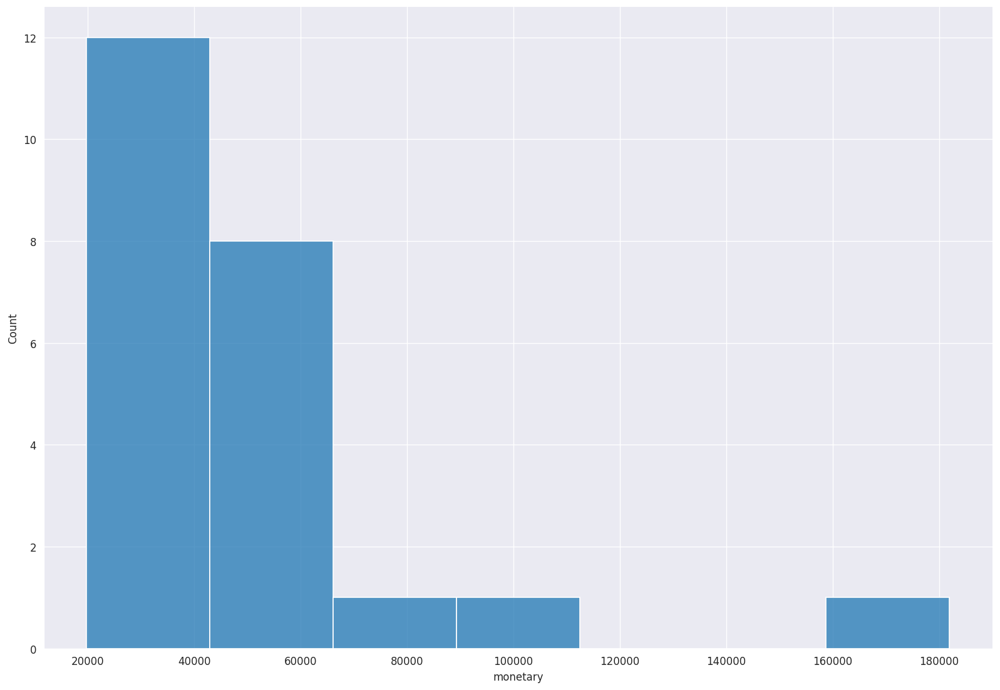

In [181]:
p = sns.displot(outliers['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

### Monetary

## Method LOF

In [182]:
from pyod.models.lof import LOF

In [184]:
df = dfa_dropid_rn

In [185]:
lof = LOF(contamination=0.05, n_neighbors=20, n_jobs=-1)
lof.fit(df)

is_outlier = lof.labels_ == 1

outliers = df[is_outlier]

print(len(outliers))

14666


In [186]:
outliers.describe()

,duration,monetary,recency,frequency
count,14666.000000,14666.000000,14666.000000,14666.000000
mean,13.235393,69.388381,18.055298,1.112778
std,20.310857,2320.927551,9.612684,1.537562
min,2.003800,0.000000,0.000000,1.000000
25%,5.951913,0.000000,10.000000,1.000000
50%,9.645233,0.000000,21.000000,1.000000
75%,17.472550,0.000000,27.000000,1.000000
max,714.778732,181900.000000,30.000000,31.000000


In [187]:
outliers.to_csv("lof_od.csv")

# Process missing data

+ Bỏ qua
+ Xử lý tay (không tự động, bán tự động)
+ Dùng giá trị thay thế (tự động): hằng số toàn cục, trị phổ biến nhất,
trung bình toàn cục, trung bình cục bộ, trị dự đoán, …
+ Ngăn chặn dữ liệu bị thiếu: thiết kế tốt CSDL và các thủ tục nhập
liệu (các ràng buộc dữ liệu)

# Clustering kmeans

In [83]:
# Load packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import calinski_harabasz_score
from sklearn.cluster import KMeans

sns.set_style("darkgrid")

df = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T10/RFMD_clustering.csv")

In [84]:
df = df.drop(columns = 'account_id')

In [85]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 293305 entries, 0 to 293304
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   duration   293305 non-null  float64
 1   recency    293305 non-null  int64  
 2   frequency  293305 non-null  int64  
 3   monetary   293305 non-null  float64
dtypes: float64(2), int64(2)
memory usage: 9.0 MB


In [86]:
columns_for_clustering = ["duration", "recency","frequency", "monetary"]

df_features = df[columns_for_clustering]

df_features.describe()

,duration,recency,frequency,monetary
count,293305.000000,293305.000000,293305.000000,293305.000000
mean,30.144090,14.438404,2.777409,8.903655
std,22.886901,9.632920,4.089070,212.011142
min,2.000033,0.000000,1.000000,0.000000
25%,13.490434,6.000000,1.000000,0.000000
50%,25.001544,15.000000,1.000000,0.000000
75%,40.196413,23.000000,3.000000,0.000000
max,115.390056,30.000000,31.000000,16800.000000


In [120]:
scaler = StandardScaler()
customers_scaled = scaler.fit_transform(df_features)

In [121]:
customers_scaled = pd.DataFrame(customers_scaled, 
                                columns = ["duration", "recency","frequency", "monetary"])

In [122]:
customers_scaled.describe().round(2)

,duration,recency,frequency,monetary
count,293305.00,293305.00,293305.00,293305.00
mean,0.00,0.00,0.00,-0.00
std,1.00,1.00,1.00,1.00
min,-1.23,-1.50,-0.43,-0.04
25%,-0.73,-0.88,-0.43,-0.04
50%,-0.22,0.06,-0.43,-0.04
75%,0.44,0.89,0.05,-0.04
max,3.72,1.62,6.90,79.20


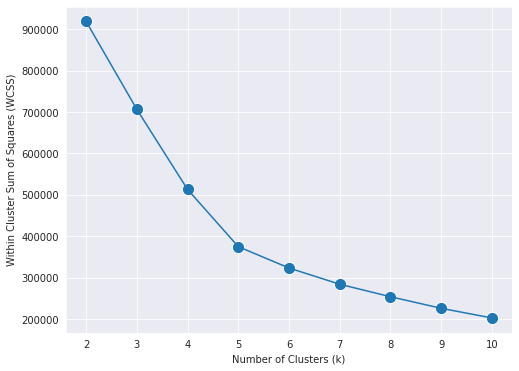

In [123]:
wcss = []
for k in range(2, 11):
    km = KMeans(n_clusters = k, n_init = 25, random_state = 1234)
    km.fit(customers_scaled)
    wcss.append(km.inertia_)

wcss_series = pd.Series(wcss, index = range(2, 11))

plt.figure(figsize=(8, 6))
ax = sns.lineplot(y = wcss_series, x = wcss_series.index)
ax = sns.scatterplot(y = wcss_series, x = wcss_series.index, s = 150)
ax = ax.set(xlabel = 'Number of Clusters (k)', 
            ylabel = 'Within Cluster Sum of Squares (WCSS)')

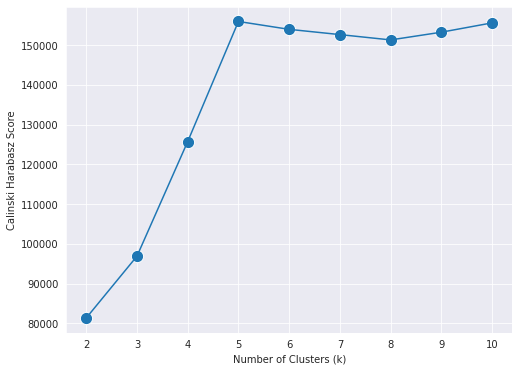

In [91]:
calinski = []
for k in range(2, 11):
    km = KMeans(n_clusters = k, n_init = 25, random_state = 1234)
    km.fit(customers_scaled)
    calinski.append(calinski_harabasz_score(customers_scaled, km.labels_))

calinski_series = pd.Series(calinski, index = range(2, 11))

plt.figure(figsize=(8, 6))
ax = sns.lineplot(y = calinski_series, x = calinski_series.index)
ax = sns.scatterplot(y = calinski_series, x = calinski_series.index, s = 150)
ax = ax.set(xlabel = 'Number of Clusters (k)', 
            ylabel = 'Calinski Harabasz Score')

In [124]:
km = KMeans(n_clusters = 5, n_init = 25, random_state = 1234)

In [125]:
km.fit(customers_scaled)

KMeans(n_clusters=5, n_init=25, random_state=1234)

In [126]:
km.labels_

array([1, 0, 1, ..., 1, 1, 1], dtype=int32)

In [127]:
km.inertia_

375244.7653347782

In [128]:
pd.Series(km.labels_).value_counts().sort_index()

0    127161
1    111319
2       131
3      9970
4     44724
dtype: int64

In [129]:
km.cluster_centers_

array([[-4.17035215e-01,  8.74202866e-01, -2.84725341e-01,
        -4.02812803e-02],
       [-3.23755156e-01, -8.71522122e-01, -7.75149549e-02,
        -3.90413347e-02],
       [ 7.07336121e-01, -1.36018447e+00,  5.65679350e+00,
         3.91645655e+01],
       [ 1.09623893e+00, -1.26448000e+00,  4.44990405e+00,
         5.75831339e-01],
       [ 1.74956536e+00, -3.06546880e-02, -6.77018192e-03,
        -3.15105952e-02]])

In [130]:
cluster_centers = pd.DataFrame(km.cluster_centers_, columns = ["duration", "recency","frequency", "monetary"])
cluster_centers

,duration,recency,frequency,monetary
0,-0.417035,0.874203,-0.284725,-0.040281
1,-0.323755,-0.871522,-0.077515,-0.039041
2,0.707336,-1.360184,5.656794,39.164565
3,1.096239,-1.264480,4.449904,0.575831
4,1.749565,-0.030655,-0.006770,-0.031511


In [132]:
k = 5

kmeans = KMeans(n_clusters=k, random_state=1) 
kmeans.fit(customers_scaled)
cluster_labels = kmeans.labels_
# df_clustered = df.assign(Cluster=cluster_labels)
df_clustered = customers_scaled.assign(Cluster=cluster_labels)
df_clustered

,duration,recency,frequency,monetary,Cluster
0,-0.114005,-1.498863,0.054436,-0.041996,0
1,-0.114005,0.162111,-0.434674,-0.041996,4
2,-0.114005,-1.498863,1.032655,1.373026,0
3,-0.114005,-1.498863,6.901969,-0.041996,3
4,-0.114005,-0.149322,-0.434674,-0.041996,0
...,...,...,...,...,...
293300,-1.229652,-0.356944,-0.434674,-0.041996,0
293301,-1.229680,-0.149322,-0.434674,-0.041996,0
293302,-1.229684,-0.460755,-0.434674,-0.041996,0
293303,-1.229700,-0.668376,-0.434674,-0.041996,0


In [133]:
df_sizes = df_clustered.groupby(["Cluster"], as_index=False).size()
df_sizes

,Cluster,size
0,0,111307
1,1,132
2,2,44885
3,3,9984
4,4,126997


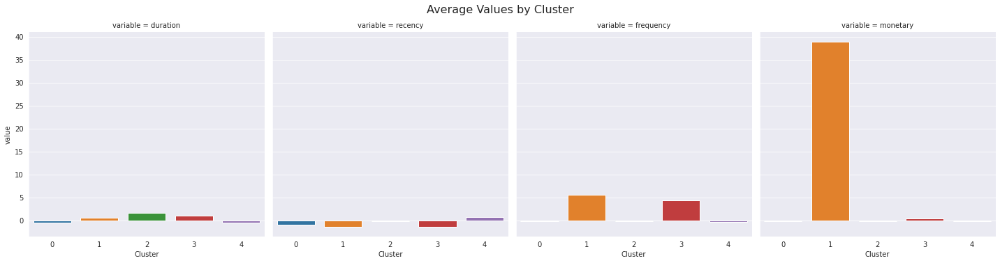

In [134]:
df_means = df_clustered.groupby(["Cluster"])[df_features.columns].mean().reset_index()

sns.catplot(
    data=df_means.melt(id_vars="Cluster"), 
    col="variable",
    x="Cluster",
    y="value",
    kind="bar",
)

plt.suptitle("Average Values by Cluster", y=1.04, fontsize=16)

plt.show()

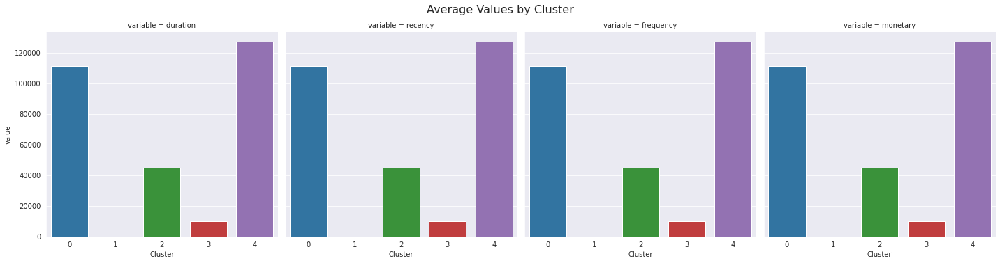

In [102]:
df_count = df_clustered.groupby(["Cluster"])[df_features.columns].count().reset_index()

sns.catplot(
    data=df_count.melt(id_vars="Cluster"), 
    col="variable",
    x="Cluster",
    y="value",
    kind="bar",
)

plt.suptitle("Average Values by Cluster", y=1.04, fontsize=16)

plt.show()

In [103]:
df['Cluster'] = km.labels_.tolist()
df.head(10)

,duration,recency,frequency,monetary,Cluster
0,27.534874,0,3,0.0,1
1,27.534874,16,1,0.0,0
2,27.534874,0,7,300.0,1
3,27.534874,0,31,0.0,3
4,27.534874,13,1,0.0,1
5,27.534874,30,1,0.0,0
6,27.534874,27,4,2000.0,0
7,27.534874,5,22,0.0,3
8,27.534874,18,9,0.0,0
9,27.534874,9,1,0.0,1


In [104]:
df.groupby('Cluster').agg({
    'recency': 'min',
    'frequency': 'min',
    'duration': 'min',
    'monetary': 'min'}).round(2)

,recency,frequency,duration,monetary
Cluster,,,,
0,14,1,2.00,0.0
1,0,1,2.00,0.0
2,0,2,19.31,4250.0
3,0,6,2.03,0.0
4,0,1,38.75,0.0


In [105]:
df.groupby('Cluster').agg({
    'recency': 'max',
    'frequency': 'max',
    'duration': 'max',
    'monetary': 'max'}).round(2)

,recency,frequency,duration,monetary
Cluster,,,,
0,30,13,57.65,2850.0
1,17,14,56.49,3500.0
2,25,31,115.29,16800.0
3,20,31,115.39,4200.0
4,30,14,115.39,2500.0


In [106]:
df.groupby('Cluster').agg({
    'recency': 'count',
    'frequency': 'count',
    'duration': 'count',
    'monetary': 'count'}).round(2)

,recency,frequency,duration,monetary
Cluster,,,,
0,127161,127161,127161,127161
1,111319,111319,111319,111319
2,131,131,131,131
3,9970,9970,9970,9970
4,44724,44724,44724,44724


In [107]:
df.groupby('Cluster').agg({
    'recency': 'describe',
    'frequency': 'describe',
    'duration': 'describe',
    'monetary': 'describe'}).round(2).to_csv("T10_clustering.csv")

In [108]:
df.groupby('Cluster').agg({
    'recency': 'describe',
    'frequency': 'describe',
    'duration': 'describe',
    'monetary': 'describe'}).round(2)

recency                                            frequency         \
            count   mean   std   min   25%   50%   75%   max     count   mean   
Cluster                                                                         
0        127161.0  22.86  4.81  14.0  19.0  23.0  27.0  30.0  127161.0   1.61   
1        111319.0   6.05  4.40   0.0   2.0   6.0   9.0  17.0  111319.0   2.46   
2           131.0   1.34  3.88   0.0   0.0   0.0   0.0  25.0     131.0  25.91   
3          9970.0   2.25  3.81   0.0   0.0   0.0   3.0  20.0    9970.0  20.98   
4         44724.0  14.13  8.98   0.0   7.0  15.0  22.0  30.0   44724.0   2.75   

         ... duration          monetary                                    \
         ...      75%     max     count     mean      std     min     25%   
Cluster  ...                                                                
0        ...    28.86   57.65  127161.0     0.36    21.03     0.0     0.0   
1        ...    31.04   56.49  111319.0     0.63    24.62     0.0     0.0   
2        ...    60.91  115.29     131.0  8312.21  3443.92  4250.0  5250.0   
3        ...    75.27  115.39    9970.0   131.13   472.10     0.0     0.0   
4        ...    81.56  115.39   44724.0     2.22    46.47     0.0     0.0   

                                   
            50%      75%      max  
Cluster                            
0           0.0      0.0   2850.0  
1           0.0      0.0   3500.0  
2        7500.0  10575.0  16800.0  
3           0.0      0.0   4200.0  
4           0.0      0.0   2500.0  

[5 rows x 32 columns]

In [142]:
df_cm = df.groupby('Cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'duration': 'mean',
    'monetary': 'mean'}).round(2)

In [144]:
df_cm.mean()

recency         9.326
frequency      10.742
duration       43.006
monetary     1689.310
dtype: float64

In [140]:
df.groupby('Cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'duration': 'mean',
    'monetary': 'mean'}).round(2)
# 0: R↑ F↓ D↓ M↑ -> 4
# 1: R↓ F↓ D↓ M↓ -> 3
# 2: R↓ F↑ D↑ M↑ -> 1
# 3: R↓ F↑ D↑ M↓ -> 2
# 4: R↑ F↓ D↑ M↓ -> 5

,recency,frequency,duration,monetary
Cluster,,,,
0,22.86,1.61,20.60,0.36
1,6.05,2.46,22.71,0.63
2,1.34,25.91,46.33,8312.21
3,2.25,20.98,55.25,131.13
4,14.13,2.75,70.14,2.22


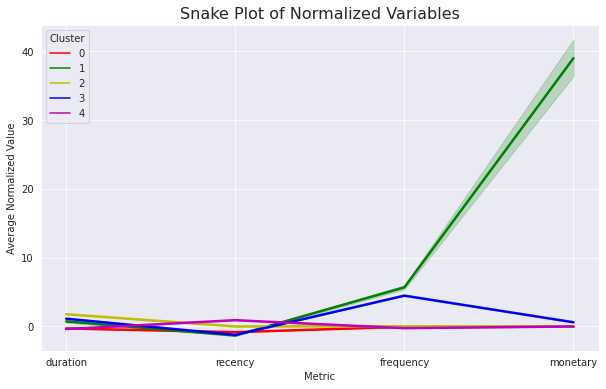

In [141]:
df_processed_clustered = df_clustered.assign(Cluster=cluster_labels)

df_processed_melt = pd.melt(
    df_processed_clustered.reset_index(),
    id_vars=['Cluster'],
    value_vars=df_features.columns,
    var_name="Metric",
    value_name="Value",
)

plt.figure(figsize=(10, 6))

plt.title('Snake Plot of Normalized Variables', fontsize=16)
plt.xlabel('Metric')
plt.ylabel('Average Normalized Value')

sns.lineplot(data=df_processed_melt, x='Metric', y='Value', hue='Cluster', palette=['r', 'g', 'y', 'b', 'm'], linewidth=2.5)
plt.show()

In [ ]:
filter_0 = df[df['Cluster'] == 0]
filter_0

,duration,recency,frequency,monetary,Cluster
1,27.534874,16,1,0.0,0
5,27.534874,30,1,0.0,0
6,27.534874,27,4,2000.0,0
8,27.534874,18,9,0.0,0
11,27.534874,16,1,0.0,0
...,...,...,...,...,...
293295,2.002183,15,1,0.0,0
293296,2.002033,29,1,0.0,0
293297,2.001817,22,1,0.0,0
293298,2.001567,23,1,0.0,0


In [ ]:
filter_1 = df[df['Cluster'] == 1]
filter_1

,duration,recency,frequency,monetary,Cluster
0,27.534874,0,3,0.0,1
2,27.534874,0,7,300.0,1
4,27.534874,13,1,0.0,1
9,27.534874,9,1,0.0,1
12,27.534874,1,1,0.0,1
...,...,...,...,...,...
293300,2.001217,11,1,0.0,1
293301,2.000583,13,1,0.0,1
293302,2.000483,10,1,0.0,1
293303,2.000117,8,1,0.0,1


In [ ]:
filter_2 = df[df['Cluster'] == 2]
filter_2

,duration,recency,frequency,monetary,Cluster
89,27.534874,0,31,4700.0,2
93,27.534874,14,2,15300.0,2
154,27.534874,0,31,10300.0,2
268,27.534874,0,28,4500.0,2
353,27.534874,0,31,6000.0,2
...,...,...,...,...,...
79060,41.535703,1,17,10000.0,2
95607,36.371166,3,12,4750.0,2
115903,31.101504,7,20,12500.0,2
162145,22.290478,0,16,5000.0,2


# Test Clustering

In [ ]:
df_all_rn

,duration,monetary,recency,frequency,account_id
0,714.778732,0,0,3,635c8cf81505f828cf79d3d6
1,700.352309,0,16,1,6349a08e1505f828cf787f36
2,679.467301,300,0,7,635724051505f828cf798504
3,665.620019,0,0,31,631dcac71505f8fb5aab0c72
4,632.563903,0,13,1,634dfd161505f828cf78de64
...,...,...,...,...,...
293300,2.001217,0,11,1,6350f59a1505f828cf790c1f
293301,2.000583,0,13,1,634e61951505f828cf78e4f8
293302,2.000483,0,10,1,63526ed21505f828cf7923ea
293303,2.000117,0,8,1,630d9e051505f8fb5aa87708


In [ ]:
df = df_all_rn.drop(columns=['account_id'])

In [ ]:
duration_quartile = pd.qcut(df['duration'], q=4, labels=range(1,5))

df['duration_quartile'] = duration_quartile

print(df.sort_values('duration'))

          duration  monetary  recency  frequency duration_quartile
293304    2.000033         0        5          1                 1
293303    2.000117         0        8          1                 1
293302    2.000483         0       10          1                 1
293301    2.000583         0       13          1                 1
293300    2.001217         0       11          1                 1
...            ...       ...      ...        ...               ...
4       632.563903         0       13          1                 4
3       665.620019         0        0         31                 4
2       679.467301       300        0          7                 4
1       700.352309         0       16          1                 4
0       714.778732         0        0          3                 4

[293305 rows x 5 columns]


In [ ]:
# Assigning labels
r_labels = list(range(4, 0, -1))

recency_quartiles = pd.qcut(df['recency'], q=4, labels=r_labels)

df['recency_quartile'] = recency_quartiles 

print(df.sort_values('recency'))

          duration  monetary  recency  frequency duration_quartile  \
0       714.778732         0        0          3                 4   
47488    56.706719         0        0         26                 4   
233825   11.220434         0        0          1                 1   
137290   26.726765         0        0         11                 3   
17244    92.429273         0        0          2                 4   
...            ...       ...      ...        ...               ...   
98138    35.606833         0       30          1                 3   
274621    4.989600         0       30          1                 1   
274620    4.989600         0       30          1                 1   
166739   21.481934         0       30          1                 2   
47661    56.583998         0       30          1                 4   

       recency_quartile  
0                     4  
47488                 4  
233825                4  
137290                4  
17244                 4  
...

In [ ]:
# Custom label
r_labels = ['Activate', 'Lapsed', 'Inactive', 'Churned']
recency_quartiles = pd.qcut(df['recency'], q=4, labels=r_labels)
df['recency_quartile'] = recency_quartiles
df.sort_values('recency')

,duration,monetary,recency,frequency,duration_quartile,recency_quartile
0,714.778732,0,0,3,4,Activate
47488,56.706719,0,0,26,4,Activate
233825,11.220434,0,0,1,1,Activate
137290,26.726765,0,0,11,3,Activate
17244,92.429273,0,0,2,4,Activate
...,...,...,...,...,...,...
98138,35.606833,0,30,1,3,Churned
274621,4.989600,0,30,1,1,Churned
274620,4.989600,0,30,1,1,Churned
166739,21.481934,0,30,1,2,Churned
